# Houston Audubon Bird Detection Tutorial 
Authors: Krish Kabra, Alexander Xiong, Minxuan Luo, William Lu 

This Colab notebook contains tutorial code to perform bird detection using drone imagery based on the work done by Houston Audubon and students from the D2K capstone project course at Rice University. 

## Installation and setup for Colab

Run the next cells to setup Colab with the necessary requirements. We clone the Github repo with the developed code, and install dependencies, namely Detectron2. 

In [1]:
# Import useful libraries
import os, sys, shutil, glob
import numpy as np
import matplotlib.pyplot as plt 
import pandas as pd 
import cv2
from skimage import io  
from datetime import datetime
from distutils.dir_util import copy_tree

Mounted at /gdrive/


In [2]:
# This cell only excecutes if you're running on Colab. 
if 'google.colab' in sys.modules:
  from google.colab import drive 
  drive.mount('/gdrive/') # Mount Google Drive! 

  # Clone Audubon bird detection Github repo 
  !git clone -b SP22 https://github.com/RiceD2KLab/Audubon_F21.git 

  # Install dependencies 
  !pip install -qq pyyaml==5.1
  # This is the current pytorch version on Colab. Uncomment this if Colab changes its pytorch version
  !pip install -qq torch==1.9.0+cu102 torchvision==0.10.0+cu102 -f https://download.pytorch.org/whl/torch_stable.html

  # Install detectron2 that matches the above pytorch version
  # See https://detectron2.readthedocs.io/tutorials/install.html for instructions
  !pip install -qq detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu102/torch1.9/index.html
  # exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

  !pip install -qq wandb

Mounted at /gdrive/
Cloning into 'Audubon_F21'...
remote: Enumerating objects: 545, done.
remote: Counting objects: 100% (545/545), done.
remote: Compressing objects: 100% (301/301), done.
remote: Total 545 (delta 295), reused 475 (delta 232), pack-reused 0
Receiving objects: 100% (545/545), 38.45 MiB | 23.43 MiB/s, done.
Resolving deltas: 100% (295/295), done.
     |████████████████████████████████| 274 kB 7.5 MB/s 
     |████████████████████████████████| 831.4 MB 3.1 kB/s 
     |████████████████████████████████| 22.1 MB 1.6 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchtext 0.11.0 requires torch==1.10.0, but you have torch 1.9.0+cu102 which is incompatible.
torchaudio 0.10.0+cu111 requires torch==1.10.0, but you have torch 1.9.0+cu102 which is incompatible.
     |████████████████████████████████| 6.4 MB 685 kB/s 
     |███████████████████████████

## Data exploration & wrangling

The following cells contain the data exploration and wrangling modules of the data science pipeline. 


### Load dataset from Google Drive 

The following cell unzips a folder stored on Google Drive ontop the Colab machine. You can modify this cell to load your drone images onto the Colab instance! 


In [3]:
!mkdir -p './data/raw'
!gdown -q https://drive.google.com/uc?id=1zhB6_MLtvD0JCoyKYqhUx497WIvSYVUk
!unzip -q './1017_1.zip' -d './data/raw'
!gdown -q https://drive.google.com/uc?id=1clRsR5zg60FYjQ-crGx8CN88yPsUgVse
!unzip -q './1017_2.zip' -d './data/raw'
!gdown -q https://drive.google.com/uc?id=1fC4xAZJFoEccrgBhvjLMGpzLVXEcfHm6
!unzip -q './annotation_1017.zip' -d './data/raw'

Access denied with the following error:

 	Cannot retrieve the public link of the file. You may need to change
	the permission to 'Anyone with the link', or have had many accesses. 

You may still be able to access the file from the browser:

	 https://drive.google.com/uc?id=1zhB6_MLtvD0JCoyKYqhUx497WIvSYVUk 

unzip:  cannot find or open ./1017_1.zip, ./1017_1.zip.zip or ./1017_1.zip.ZIP.
Access denied with the following error:

 	Cannot retrieve the public link of the file. You may need to change
	the permission to 'Anyone with the link', or have had many accesses. 

You may still be able to access the file from the browser:

	 https://drive.google.com/uc?id=1clRsR5zg60FYjQ-crGx8CN88yPsUgVse 

unzip:  cannot find or open ./1017_2.zip, ./1017_2.zip.zip or ./1017_2.zip.ZIP.


In [4]:
!unzip -q '/gdrive/MyDrive/1017_1.zip' -d './data/raw'

In [5]:
!unzip -q '/gdrive/MyDrive/1017_2.zip' -d './data/raw'

### Data exploration 

The following cells generate some metrics and plots to help understand the loaded dataset. 

In [ ]:
# # This cell plots the distribution of bird species contained in the entire dataset
# data_dir = './data/raw' # data directory folder 

# # Load CSV files 
# target_data = []
# for f in glob.glob(os.path.join(data_dir,'*.bbx')): 
#   target_data.append(pd.read_csv(f, header=0, 
#                               names = ["class_id", "class_name", "x", "y", "width", "height"]) )
# target_data = pd.concat(target_data, axis=0, ignore_index=True)

# # Create table and bar plot of bird species  
# print('\n Bird Species Distribution')
# print(target_data["class_name"].value_counts())
# print('\n')

# ax = target_data["class_name"].value_counts().plot.bar(x="Bird Species", y="Frequency",figsize=(10,6))  
# ax.set_title('Bird Species Distribution')
# plt.show()

In [6]:
# Show an example image with corresponding bounding boxes 
from PIL import Image 
# from Audubon_F21.utils import plotting
# from Audubon_F21.utils.cropping import csv_to_dict 

# annot_dict = csv_to_dict(csv_path = './data/raw/DJI_20210520122307_0033.bbx', annot_file_ext='bbx')
# annotation_lst = [list(x.values()) for x in annot_dict['bbox']]

# image_file = './data/raw/DJI_20210520122307_0033.JPG'
# assert os.path.exists(image_file)

# #Load the image
# image = Image.open(image_file)

# #Plot the Bounding Box
# print("Raw image with bounding boxes:")
# plotting.plot_img_bbx(image, annotation_lst)

### Tiling 

In order to prepare the dataset to be used for training in our deep learning models, we must tile the large 8192 × 5460 raw drone images into smaller sizes. The size of generated images can be specified by setting parameters and is default to be 640 × 640.

The following cells tiles the original dataset images and corresponding annotations in annotation files. 

In [7]:
from Audubon_F21.utils.cropping import crop_dataset

# data_dir is the path that contains both images and annotations (image: jpg; annotation: csv or bbx)
data_dir = './data/raw' # data directory folder 
# output dir is the path where you want to output new files. Please use the folder you defined above.
output_dir = './data/tiled'

crop_dataset(data_dir, output_dir, annot_file_ext = 'bbx', crop_height = 640, crop_width = 640)

Creating output directory at: ./data/tiled


/content/Audubon_F21/utils/cropping.py:2: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm


Cropping files:   0%|          | 0/87 [00:00<?, ?it/s]

In [ ]:
from pathlib import Path
import random

def train_test_split(file_dir, output_dir, train_frac=0.8):
    """
    :param file_dir: crop_dataset()'s output path:
    :param output_dir: an empty folder
    :param train_frac: fraction for training
    :param val_frac: fraction for validation, 1-train-val will be fraction for test
    """
    p = Path(output_dir)
    p1 = Path(os.path.join(output_dir, 'train'))
    p2 = Path(os.path.join(output_dir, 'test'))

    if not p.is_dir():
        print('The output directory should be an empty folder')
    if not p1.is_dir():
        print('Please create an empty folder named "train" inside the output folder')
    if not p2.is_dir():
        print('Please create an empty folder named "test" inside the output folder')


    img_list = [f for f in os.listdir(file_dir) if f[-4:] == 'JPEG']
    random.Random(4).shuffle(img_list)
    csv_list = [f.replace('JPEG', 'csv') for f in img_list]
    size = len(img_list)
    train_sz = int(size * train_frac)
    for idx in range(size):
        if idx < train_sz:
            shutil.move(os.path.join(file_dir, img_list[idx]), os.path.join(output_dir, 'train'))
            shutil.move(os.path.join(file_dir, csv_list[idx]), os.path.join(output_dir, 'train'))
        else:          
            shutil.move(os.path.join(file_dir, img_list[idx]), os.path.join(output_dir, 'test'))
            shutil.move(os.path.join(file_dir, csv_list[idx]), os.path.join(output_dir, 'test'))

### Split dataset into training, validation, and test 


In [ ]:
#  # this is modified, only train and test sets. No validation since there is no hyperparameter tuning yet

# #  from Audubon_F21.utils.cropping import train_test_split

# # create a new output folder for train, val, test dataset
# # create three folders under the new output folder, with name 'train', 'val', 'test'
# !mkdir -p /content/data/split
# !mkdir -p /content/data/split/train
# !mkdir -p /content/data/split/test

# # specify the folder directory where you have the tiled images (output_dir of the crop_dataset() function)
# file_dir = '/content/data/tiled'
# # output_dir is the new output folder you created in the cell above
# output_dir = '/content/data/split'
# # train is a percentage, the fraction of files for training
# train_frac = 0.8
# # the fraction for test is default to be 1-train-val
# train_test_split(file_dir, output_dir, train_frac=train_frac)

In [8]:
 # this is modified, only train and test sets. No validation since there is no hyperparameter tuning yet

 from Audubon_F21.utils.cropping import train_val_test_split

# create a new output folder for train, val, test dataset
# create three folders under the new output folder, with name 'train', 'val', 'test'
# !mkdir -p /content/data/split
!mkdir -p /content/data/split/train
!mkdir -p /content/data/split/val
!mkdir -p /content/data/split/test

# specify the folder directory where you have the tiled images (output_dir of the crop_dataset() function)
file_dir = '/content/data/tiled'
# output_dir is the new output folder you created in the cell above
output_dir = '/content/data/split'
# train is a percentage, the fraction of files for training
train_frac = 0.8
# the fraction for test is default to be 1-train-val
val_frac = 0.1

train_val_test_split(file_dir, output_dir, train_frac=train_frac,val_frac = 0.1)

In [9]:
# Distribution of bird species for train, val, and test sets
# data directory folders 
data_dir = 'data/split'
dirs = [d for d in os.listdir(data_dir)]


# Load CSV files 
# for d in dirs:
for d in dirs:
  target_data = []
  for f in glob.glob(os.path.join(data_dir,d,'*.csv')):
    target_data.append(pd.read_csv(f, header=0, 
                              names = ["class_id", "class_name", "x", "y", "width", "height"]) )
  target_data = pd.concat(target_data, axis=0, ignore_index=True)
  
  
# Visualize dataset 
  print(f'\n {d} - Bird Species Distribution')
  print(target_data["class_name"].value_counts())
  print('\n')


 val - Bird Species Distribution
Mixed Tern Adult                   1179
Laughing Gull Adult                 358
Brown Pelican Adult                  48
Mixed Tern Flying                    29
Laughing Gull Flying                  8
Brown Pelican - Wings Spread          6
Brown Pelican Wings Spread            5
Other Bird                            5
Brown Pelican Juvenile                3
Trash/Debris                          3
Brown Pelican In Flight               3
Black Crowned Night Heron Adult       1
Great Egret/White Morph Adult         1
Tri-Colored Heron Adult               1
Name: class_name, dtype: int64



 test - Bird Species Distribution
Mixed Tern Adult                 1302
Laughing Gull Adult               387
Brown Pelican Adult                65
Mixed Tern Flying                  27
Laughing Gull Flying                9
Other Bird                          6
Great Egret/White Morph Adult       5
Brown Pelican In Flight             4
Trash/Debris                      

['val', 'test', 'train']

In [10]:
import glob, os
from cv2 import imread
import pandas as pd

from detectron2.structures import BoxMode
from detectron2.data import MetadataCatalog, DatasetCatalog

def get_bird_only_dicts(data_dir,img_ext='.JPG'):
  """
  Format dataset to detectron2 standard format. 
  INPUTS: 
    data_dir -- directory containing dataset files 
    img_ext -- file extension for images in dataset
  OUTPUTS: 
    dataset_dicts -- list of dictionaries in detectron2 standard format
  """ 
  
  dataset_dicts = []

  for idx,file_csv in enumerate(glob.glob(os.path.join(data_dir,'*.csv'))): 
    # print(file_csv)
    record = {}

    # image attributes 
    root, ext = os.path.splitext(file_csv)    
    file_img = root + img_ext
    height, width = imread(file_img).shape[:2]
    record["file_name"] = file_img
    record["image_id"] = idx
    record["height"] = height
    record["width"] = width
    
    # annotations 
    imgs_anns_df = pd.read_csv(file_csv, header=0, names = ["class_id", "class_name", "x", "y", "width", "height"])
    # skip empty images
    if imgs_anns_df.shape[0]==0: 
      continue
    # remove annotations for trash 
    imgs_anns_df = imgs_anns_df[imgs_anns_df["class_name"]!="Trash/Debris"]
    
    objs = []
    for idx, row in imgs_anns_df.iterrows():  
      obj = {
          "bbox": [row["x"], row["y"], row["width"], row["height"]],      
          "bbox_mode": BoxMode.XYWH_ABS,
          "category_id": 0,
      }
      objs.append(obj)

    record["annotations"] = objs
    dataset_dicts.append(record)

  return dataset_dicts


def get_bird_species_dicts(data_dir,class_names,img_ext='.JPG',unknown_bird_category=True,skip_empty_imgs=True):
  """
  Format dataset to detectron2 standard format. 
  INPUTS: 
    data_dir -- directory containing dataset files 
    img_ext -- file extension for images in dataset
    class_names -- names of bird species
    skip_empty_imgs -- keep images with no birds 
  OUTPUTS: 
    dataset_dicts -- list of dictionaries in detectron2 standard format
  """

  dataset_dicts = []

  for idx,file_csv in enumerate(glob.glob(os.path.join(data_dir,'*.csv'))):
    # print(file_csv)
    record = {}

    # image attributes
    root, ext = os.path.splitext(file_csv)
    file_img = root + img_ext
    # print(file_img)
    height, width = imread(file_img).shape[:2]
    record["file_name"] = file_img
    record["image_id"] = idx
    record["height"] = height
    record["width"] = width

    # annotations
    imgs_anns_df = pd.read_csv(file_csv, header=0, names = ["class_id", "class_name", "x", "y", "width", "height"])
    # skip empty images
    if skip_empty_imgs and imgs_anns_df.shape[0]==0:
      continue
    # remove annotations for trash
    imgs_anns_df = imgs_anns_df[imgs_anns_df["class_name"]!="Trash/Debris"]

    objs = []
    for idx, row in imgs_anns_df.iterrows():
      obj = None
      for id, class_name in enumerate(class_names):
        if class_name in row["class_name"]:
          # print('actural: ', class_name, ' class is: ', row["class_name"])
          obj = {
            "bbox": [row["x"], row["y"], row["width"], row["height"]],
            "bbox_mode": BoxMode.XYWH_ABS,
            "category_id": id,
          }
          objs.append(obj)
          break
      if obj is None:
        if unknown_bird_category:
          obj = {
            "bbox": [row["x"], row["y"], row["width"], row["height"]],
            "bbox_mode": BoxMode.XYWH_ABS,
            "category_id": len(class_names)
          }
          objs.append(obj)
        else:
          continue

    record["annotations"] = objs
    dataset_dicts.append(record)

  return dataset_dicts


def register_datasets(data_dirs, img_ext, birds_species_names, bird_species_colors=None):
  """
  Register dataset as part of Detectron2's dataset and metadataset catalogs
  For each dataset directory to be registered, a "bird-only" and "bird-species" dataset will be registered
  INPUTS:
    data_dirs: list of directories containing dataset images to be registered
    img_ext: file extension for images in dataset
    birds_species_names: names of bird species to be registered. Species not in this list will be registered as
                        "Unknown Bird"
    bird_species_colors: List of colors for corresponding to bird species to be used for visualizations. Color
                         format should be tuple containing RGB values between 0-255 eg. (255,0,0) for red

  """
  for data_dir in data_dirs:
    d = os.path.basename(data_dir)
    # print(d)
    # birds only
    if f"birds_only_{d}" in DatasetCatalog.list():
      DatasetCatalog.remove(f"birds_only_{d}")
    DatasetCatalog.register(f"birds_only_{d}", lambda d=d: get_bird_only_dicts(data_dir, img_ext))


    if f"birds_only_{d}" in MetadataCatalog.list():
      MetadataCatalog.remove(f"birds_only_{d}")
    MetadataCatalog.get(f"birds_only_{d}").set(thing_classes=["Bird"])

    # bird species
    if f"birds_species_{d}" in DatasetCatalog.list():
      DatasetCatalog.remove(f"birds_species_{d}")
    DatasetCatalog.register(f"birds_species_{d}", lambda d=d: get_bird_species_dicts(data_dir,
                                                                                     birds_species_names,
                                                                                     img_ext,
                                                                                     unknown_bird_category=True))
    if f"birds_species_{d}" in MetadataCatalog.list():
      MetadataCatalog.remove(f"birds_species_{d}")
    MetadataCatalog.get(f"birds_species_{d}").set(thing_classes=birds_species_names + ["Unknown Bird"])

    if bird_species_colors is not None:
      MetadataCatalog.get(f"birds_species_{d}").set(thing_colors=bird_species_colors + [(0, 0, 0)])



## Modeling 

The primary models used to detect birds within the drone images are convolutional neural network (CNN) based object detectors. To implement these models, we utilize [Detectron2](https://github.com/facebookresearch/detectron2), Facebook AI Research's next generation library that provides state-of-the-art detection and segmentation algorithms. 



### Setup dataloaders 

The following cell registers the training, validation, and testing datasets with Detectron2's dataset catalogs. Note that we register both a version that utilizes both a singular "bird-only" label and the bird species labels. 


In [15]:
# from Audubon_F21.utils.dataloader import register_datasets

data_dir = './data/split'
img_ext='.JPEG'
dirs = [os.path.join(data_dir,d) for d in os.listdir(data_dir)]

# Bird species used by object detector. Species contained in dataset that are 
# not contained in this list will be categorized as an "Unknown Bird"
BIRD_SPECIES = ["Brown Pelican", "Laughing Gull", "Mixed Tern",
                "Great Blue Heron","Great Egret/White Morph"]
birds_species_names = ["Brown Pelican", "Laughing Gull", "Mixed Tern",
                "Great Blue Heron","Great Egret/White Morph"]                

# Bounding box colors for bird species (used when plotting images)
BIRD_SPECIES_COLORS = [(255,0,0), (255,153,51), (0, 255, 0), 
                       (0,0,255), (255, 51, 255)]

# BIRD_SPECIES = ["Brown Pelican", "Laughing Gull", "Mixed Tern"]
                       
# BIRD_SPECIES_COLORS = [(255,0,0), (255,153,51), (0, 255, 0)]

register_datasets(dirs,img_ext,BIRD_SPECIES,bird_species_colors=BIRD_SPECIES_COLORS)

In [24]:
data_dir = '/content/data/split/val'


DatasetCatalog.register('bin_try_val', lambda d=d: get_bird_species_dicts(data_dir, birds_species_names,img_ext = '.JPEG',unknown_bird_category=True))

In [ ]:
# dd = DatasetCatalog.get('bin_try_val')

In [17]:
# DatasetCatalog.remove('bird_species_test')

### Training 

The following cells train a RetinaNet and Faster R-CNN model with a ResNet-50 FPN backbone. The model weights are initialized from a model pretrained on the MS COCO dataset. The training loop is based on Detectron2's Default Trainer.  Hyperparameters can be tweaked! 

#### Bird-only model

The bird-only model simplies localizes all birds and does not distiguish bird species. We utilize RetinaNet for faster performance rather than accuracy. 

In [ ]:
from detectron2.utils.logger import setup_logger
from detectron2.config import get_cfg
from detectron2 import model_zoo
from Audubon_F21.utils.trainer import Trainer

# setup training logger 
setup_logger()

model_name = "retinanet_R_50_FPN_1x"

# Create detectron2 config 
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file(f"COCO-Detection/{model_name}.yaml"))
# Get pretrained model from MS COCO
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(f"COCO-Detection/{model_name}.yaml")

# add datasets used for training and validation 
cfg.DATASETS.TRAIN = ("birds_only_train",)
cfg.DATASETS.TEST = ("birds_only_val",)

cfg.DATALOADER.NUM_WORKERS = 2
cfg.SOLVER.IMS_PER_BATCH = 8
cfg.SOLVER.BASE_LR = 1e-3 # pick a good LR
cfg.SOLVER.GAMMA = 0.1 # pick a good LR
cfg.SOLVER.WARMUP_ITERS = 1
cfg.MODEL.RETINANET.NUM_CLASSES = 1
cfg.SOLVER.MAX_ITER = 1000
cfg.SOLVER.STEPS = [500,]
cfg.SOLVER.CHECKPOINT_PERIOD = 500

cfg.OUTPUT_DIR = f"./output/multibirds_{model_name}"
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

# train on bird species
trainer = Trainer(cfg)
# trainer.resume_or_load(resume=False)
# trainer.train()

In [ ]:
DatasetCatalog.remove('bin_try_val')

In [ ]:
d = DatasetCatalog.get('birds_only_val')


In [ ]:
d = 'val'


In [ ]:
# 

#### Bird species 

The bird species model both localizes and classifies bird species. We registered the species to be classifed in the above dataloader (see BIRD_SPECIES list). We utilize Faster R-CNN for better performance. 

In [12]:
from detectron2.utils.logger import setup_logger
from detectron2.config import get_cfg
from detectron2 import model_zoo
from Audubon_F21.utils.trainer import Trainer

# setup training logger 
setup_logger()

model_name = "faster_rcnn_R_50_FPN_1x"

# Create detectron2 config 
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file(f"COCO-Detection/{model_name}.yaml"))
# Get pretrained model from MS COCO
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(f"COCO-Detection/{model_name}.yaml")

# add datasets used for training and validation 
cfg.DATASETS.TRAIN = ("birds_species_train",)
cfg.DATASETS.TEST = ("birds_species_val",)

cfg.DATALOADER.NUM_WORKERS = 2
cfg.SOLVER.IMS_PER_BATCH = 8
cfg.SOLVER.BASE_LR = 1e-3 # pick a good LR
cfg.SOLVER.GAMMA = 0.1 # pick a good LR
cfg.SOLVER.WARMUP_ITERS = 1
cfg.MODEL.ROI_HEADS.NUM_CLASSES = len(BIRD_SPECIES)
cfg.SOLVER.MAX_ITER = 1000
cfg.SOLVER.STEPS = [500,]
cfg.SOLVER.CHECKPOINT_PERIOD = 500

cfg.OUTPUT_DIR = f"./output/multibirds_{model_name}"
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

# train on bird species
trainer = Trainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

In [ ]:
from detectron2.modeling import build_model

In [ ]:
model = build_model(cfg)

In [ ]:
from detectron2.checkpoint import DetectionCheckpointer

In [ ]:
checkpointer = DetectionCheckpointer(model, save_dir="./output")
checkpointer.save("model_3_bird")

### Evaluation

The following cell outputs various evaluation metrics, plots, and images. Please read more about the [COCO evaluation metrics](https://cocodataset.org/#detection-eval) to understand how the AP metrics are calculated. 

#### Bird-only

In [ ]:
from detectron2.engine import DefaultPredictor
from Audubon_F21.utils.evaluation import plot_precision_recall

cfg.MODEL.WEIGHTS = "./output/bird_only_retinanet_R_50_FPN_1x/model_final.pth" # path to the model we just trained
predictor = DefaultPredictor(cfg)

print('validation inference:')
val_precisions, val_max_recalls = get_precisions_recalls(cfg, predictor, "birds_only_val")
plot_precision_recall(val_precisions, val_max_recalls, ["Bird"])

print('test inference:')
test_precisions, test_max_recalls = get_precisions_recalls(cfg, predictor, "birds_only_test")
plot_precision_recall(test_precisions, test_max_recalls, ["Bird"])

# Plot examples of detections on validation and testing tiled images 
for d in ["val", "test"]:
    dataset_dicts = DatasetCatalog.get(f"birds_only_{d}")
    print(f'\n {d} examples:')
    for k in random.sample(dataset_dicts, 2):
        im = cv2.imread(k["file_name"])
        outputs = predictor(im)
        outputs = outputs["instances"].to("cpu")
        outputs = outputs[outputs.scores > 0.5]
        v = Visualizer(im[:, :, ::-1],
                        metadata=MetadataCatalog.get(f"birds_only_{d}"),
                        scale=0.5)
        out = v.draw_instance_predictions(outputs)
        cv2.imshow(f'{d} prediction {i}',out.get_image()[:, :, ::-1])

#### Bird species 

In [ ]:
from detectron2.engine import DefaultPredictor
from Audubon_F21.utils.evaluation import plot_precision_recall

cfg.MODEL.WEIGHTS = "./output/multibirds_faster_rcnn_R_50_FPN_1x/model_final.pth" # path to the model we just trained
predictor = DefaultPredictor(cfg)

print('validation inference:')
val_precisions, val_max_recalls = get_precisions_recalls(cfg, predictor, "birds_species_val")
plot_precision_recall(val_precisions, val_max_recalls, BIRD_SPECIES + ["Unknown Bird"],
                      BIRD_SPECIES_COLORS + [(0, 0, 0)])

print('test inference:')
test_precisions, test_max_recalls = get_precisions_recalls(cfg, predictor, "birds_species_test")
plot_precision_recall(test_precisions, test_max_recalls, BIRD_SPECIES + ["Unknown Bird"],
                      BIRD_SPECIES_COLORS + [(0, 0, 0)])

# Plot examples of detections on validation and testing tiled images 
for d in ["val", "test"]:
    dataset_dicts = DatasetCatalog.get(f"birds_species_{d}")
    print(f'\n {d} examples:')
    for k in random.sample(dataset_dicts, 2):
        im = cv2.imread(k["file_name"])
        outputs = predictor(im)
        outputs = outputs["instances"].to("cpu")
        outputs = outputs[outputs.scores > 0.5]
        v = Visualizer(im[:, :, ::-1],
                        metadata=MetadataCatalog.get(f"birds_species_{d}"),
                        scale=0.5,
                        instance_mode=ColorMode.SEGMENTATION)
        out = v.draw_instance_predictions(outputs)
        cv2.imshow(f'{d} prediction {i}',out.get_image()[:, :, ::-1])

## Running trained model on dataset

The following cells run a pretrained model on a dataset containing only raw images. It generates an output csv file containing the predicted bounding boxes after non-maximal suppression. 


### Tiling

The tiling step in the detection pipeline is done using a sliding window. The sub-images are deliberately generated to have a significant proportion of overlapping with adjacent sub-images. The level of overlapping can be specified by setting a parameter. The reason why we want to have the overlapping is because we can ensure that there is at least one complete version of each bird in one of the sub-images. We then try to eliminate overlapping predicted bounding boxes for the same bird by using non-maximum suppression.



In [ ]:
from Audubon_F21.utils.cropping import crop_dataset_img_only

# create folder to contain tiled images
!rm -rf './data/crop'
!mkdir -p './data/crop'

# perform tiling on images 
data_dir = './data/raw' # data directory folder 
output_dir = './data/crop'
img_ext = '.JPG'
CROP_WIDTH = 640 
CROP_HEIGHT = 640
SLIDING_SIZE = 400 
crop_dataset_img_only(data_dir, img_ext, output_dir, crop_height=CROP_HEIGHT, crop_width=CROP_WIDTH, sliding_size=SLIDING_SIZE)

### Run pipeline

In [ ]:
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from Audubon_F21.utils.evaluation import evaluate_full_pipeline

# create list of tiled images to be run predictor on 
eval_file_lst = []
eval_file_lst = eval_file_lst + glob.glob('./data/crop/*.JPEG')

# Create detectron2 config and predictor 
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_1x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# download model weights
# !gdown -q https://drive.google.com/uc?id=1-f_INg5D0yG7AJUkuSJUcIl6BSaf-smR 
# load model weights 
cfg.MODEL.WEIGHTS = "/model_final.pth"


BIRD_SPECIES = ["Brown Pelican", "Laughing Gull", "Mixed Tern",
                "Great Blue Heron","Great Egret/White Morph"]
SPECIES_MAP = {0: 'Brown Pelican', 1: 'Laughing Gull', 2: 'Mixed Tern', 3: 'Great Blue Heron',
               4: 'Great Egret/White Morph', 5: 'Other/Unknown'}

cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.ROI_HEADS.NUM_CLASSES = len(BIRD_SPECIES) 

# Create default predictor to run inference 
predictor = DefaultPredictor(cfg)
RAW_IMG_WIDTH = 8192
RAW_IMG_HEIGHT = 5460

# Run evaluation 
output_df = evaluate_full_pipeline(eval_file_lst, predictor, SPECIES_MAP, RAW_IMG_WIDTH, RAW_IMG_HEIGHT,
                           CROP_WIDTH, CROP_HEIGHT, SLIDING_SIZE)

NameError: ignored

### Download annotations as CSV file 


In [ ]:
from google.colab import files
output_df.to_csv('output.csv')
files.download('output.csv') 

**Configuring the confusion matrix output**

In [20]:
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor

# create list of tiled images to be run predictor on 
eval_file_lst = []
eval_file_lst = eval_file_lst + glob.glob('./data/split/test/*.JPEG')

# Create detectron2 config and predictor 
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_1x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# download model weights
# !gdown -q https://drive.google.com/uc?id=1-f_INg5D0yG7AJUkuSJUcIl6BSaf-smR 
# load model weights 
cfg.MODEL.WEIGHTS = "/gdrive/MyDrive/model_final.pth"

BIRD_SPECIES = ["Brown Pelican", "Laughing Gull", "Mixed Tern",
                "Great Blue Heron","Great Egret/White Morph"]
SPECIES_MAP = {0: 'Brown Pelican', 1: 'Laughing Gull', 2: 'Mixed Tern', 3: 'Great Blue Heron',
               4: 'Great Egret/White Morph', 5: 'Other/Unknown'}

cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.ROI_HEADS.NUM_CLASSES = len(BIRD_SPECIES) 

# Create default predictor to run inference 
predictor = DefaultPredictor(cfg)
RAW_IMG_WIDTH = 8192
RAW_IMG_HEIGHT = 5460

NameError: ignored

In [26]:
# THis cell is for testing how to get confusion matrix

import torch
from detectron2.data import DatasetCatalog

  
# DatasetCatalog.register('bin_test', lambda d=d: get_bird_species_dicts('/content/data/split/test',birds_species_names,img_ext = '.JPEG',unknown_bird_category=True))
data = DatasetCatalog.get("bin_test");



In [27]:
def iou(box1, box2):
  # this function figures out the bounding box overlap

  x_left = max(box1[0], box2[0])
  y_top = max(box1[1], box2[1])
  x_right = min(box1[2], box2[2])
  y_bottom = min(box1[-1], box2[-1])
  
  if x_right < x_left or y_bottom < y_top:
    return 0.0

  intersection_area = (x_right - x_left) * (y_bottom - y_top)
  bb1_area = (box1[2]-box1[0])*(box1[-1]-box1[1])
  bb2_area = (box2[2]-box2[0])*(box2[-1]-box2[1])
  iou = intersection_area / float(bb1_area + bb2_area - intersection_area)
  
  assert iou >= 0.0
  assert iou <= 1.0
  return iou


In [28]:
data[0]['file_name']

'/content/data/split/test/DJI_20210520121407_0709_2_1.JPEG'

In [29]:
data[0]['file_name']

from tqdm.autonotebook import tqdm

In [30]:
# vv = []
# cat0 = 0
# cat1 = 0
# cat2 = 0
# for d in tqdm(data):
#     annt = d['annotations']
#     file = d['file_name']
#     im = cv2.imread(file)
#     outputs = predictor(im)
#     outputs = outputs["instances"].to("cpu")
#     lst = list(outputs._fields.items())
#     pred_species  = (lst[-1][1]).numpy()
#     for i in pred_species:
#       if i == 0:
#         cat0+=1
#       elif i==1:
#         cat1 +=1
#       elif i==2:
#         cat2+=1
    


In [33]:
# making the output dir for the images which were wrongly classified
!mkdir -p ./wrong

In [69]:
from PIL import Image, ImageDraw


def plot_img_bbx_wrong(image, annotation_lst, annt_pred, img_file):

    
    w, h = image.size
    plotted_img = ImageDraw.Draw(image)

    # correctly annotated work
    for annot in annotation_lst:
        obj_class, desc, x_min, y_min, x_max, y_max = annot
        plotted_img.rectangle(((x_min, y_min), (x_max, y_max)), width=5, outline = (0,0,255))

    # incorrect annt
    for annot in annt_pred:
        x_min, y_min, x_max, y_max = annot
        plotted_img.rectangle(((x_min, y_min), (x_max, y_max)), width=5, outline = (255,0,0))

    plt.figure(figsize=(20, 10)) # this is for AWS imaging, 60,30 is too big for AWS sagemaker
    # plt.figure(figsize=(60, 30)) 
    plt.imshow(np.array(image), interpolation='nearest')
    plt.axis('off')
    plt.show()
    plt.savefig('./wrong/'+img_file)

In [80]:
from Audubon_F21.utils.cropping import csv_to_dict
# for i in data[36]['annotations']:
#   print(i['bbox'])
idx = 0
box = 0

pred_total = []
truth_total = []

wrong_dir = './wrong'

def confusion_matrix_report(data_cat_name, predictor):
  data = data_cat_name
  idx = 0
  for d in tqdm(data):
    annt = d['annotations']
    file = d['file_name']
    im = cv2.imread(file)
    outputs = predictor(im)
    outputs = outputs["instances"].to("cpu")
    lst = list(outputs._fields.items())
    
    # array of predicted birds (bounding box and species)

    pred_bbx = (lst[0][1].tensor).numpy()
    pred_species  = (lst[-1][1]).numpy()

    # print('pred: ', pred_bbx.shape, ' species: ', pred_species.shape)
    # print(pred_bbx.tolist())
    # print('annt: ', annt)
    # keeps track
    found = []

    annt_bbx = pd.read_csv(file.replace('JPEG', 'csv'))

    if 'TRASH' in annt_bbx['class_id'].unique():
      drop_index = []
      for ind, val in enumerate(annt_bbx['class_id']):
        if val == 'TRASH':
          drop_index.append(ind)

      annt_bbx.drop(index = drop_index, inplace = True)
    
    annt_bbx = annt_bbx[['x','y', 'width','height']].to_numpy()

    miss_bird = 0

    for birds in range(annt_bbx.shape[0]):
      box = annt_bbx[birds]
      
      # getting the x2 and y2 values
      box[2] += box[0]
      box[3] += box[1]

      ff = 0 
      for i in range(len(pred_bbx)):
        if i in found:
          continue
        iou_val = iou(box, pred_bbx[i])
        if iou_val >=.3:
          pred_total.append(pred_species[i])
          found.append(i)
          ff =1
          break

      truth_total.append(annt[birds]['category_id'])
      if ff == 0:
        pred_total.append(6)
        miss_bird +=1
    
    if annt_bbx.shape[0] !=0:

      if miss_bird/(annt_bbx.shape[0]) >.5:
        w_img = Image.open(file)

        annot_dict = csv_to_dict(csv_path = file.replace('JPEG', 'csv'), test = True, annot_file_ext='csv')
        annt_list = [list(x.values()) for x in annot_dict['bbox']]

        plot_img_bbx_wrong(w_img, annt_list, annt_pred = pred_bbx.tolist(), img_file = file.split('/')[-1])
        idx+=1

    
    if idx >100:
      break
    
  
  return pred_total, truth_total


  0%|          | 0/367 [00:00<?, ?it/s]

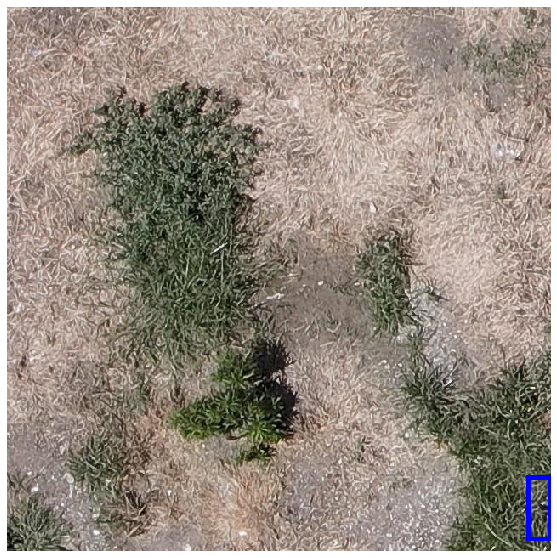

<Figure size 432x288 with 0 Axes>

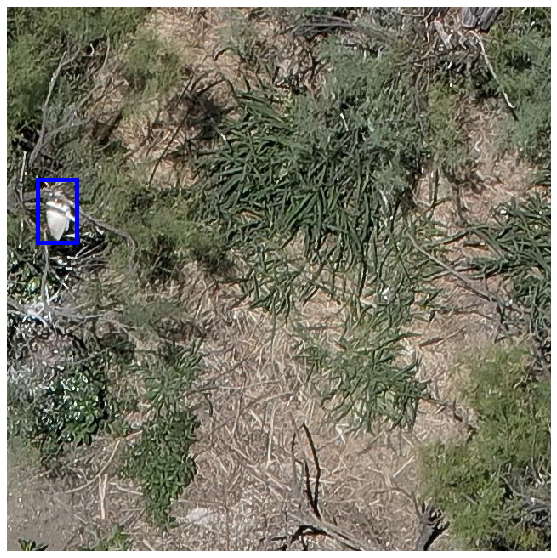

<Figure size 432x288 with 0 Axes>

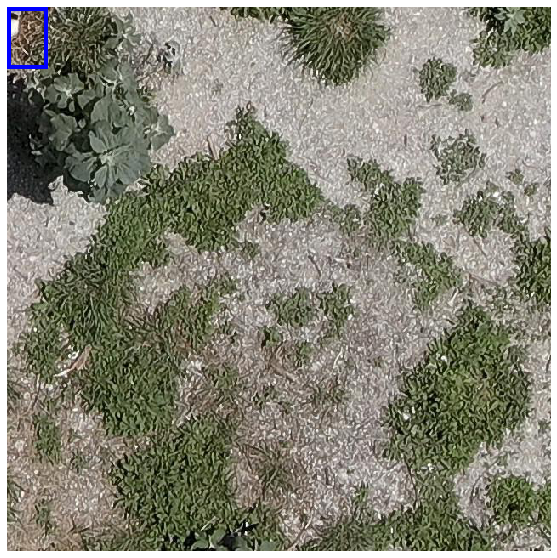

<Figure size 432x288 with 0 Axes>

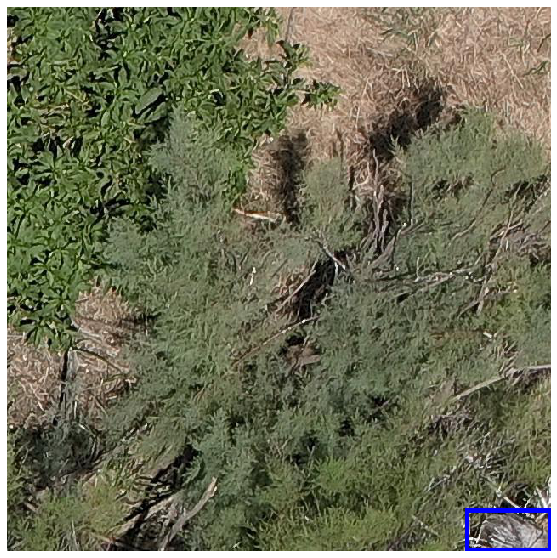

<Figure size 432x288 with 0 Axes>

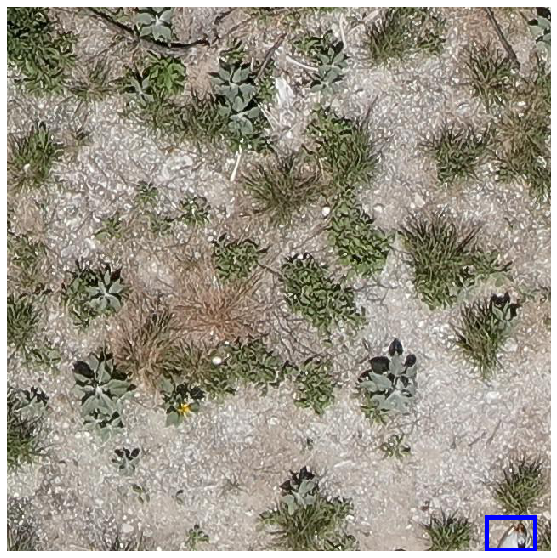

<Figure size 432x288 with 0 Axes>

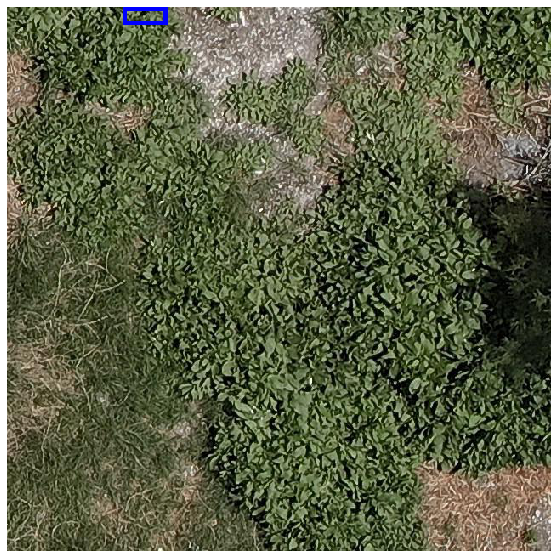

<Figure size 432x288 with 0 Axes>

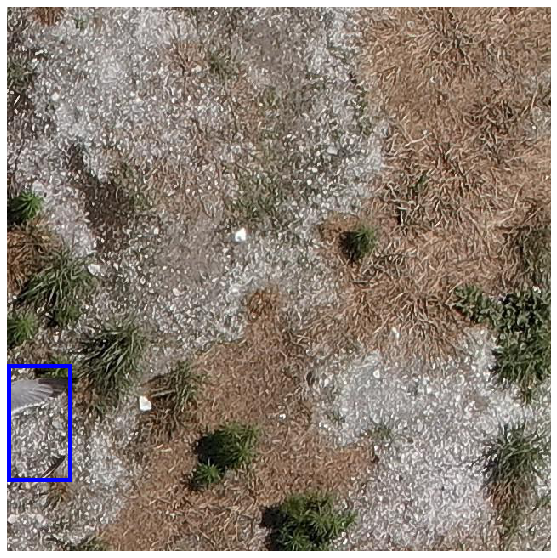

<Figure size 432x288 with 0 Axes>

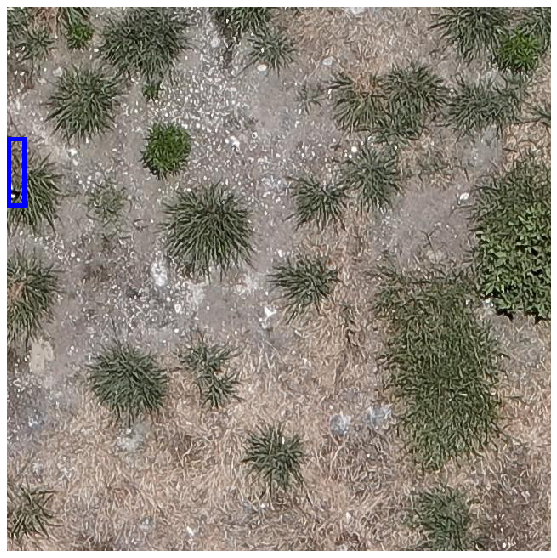

<Figure size 432x288 with 0 Axes>

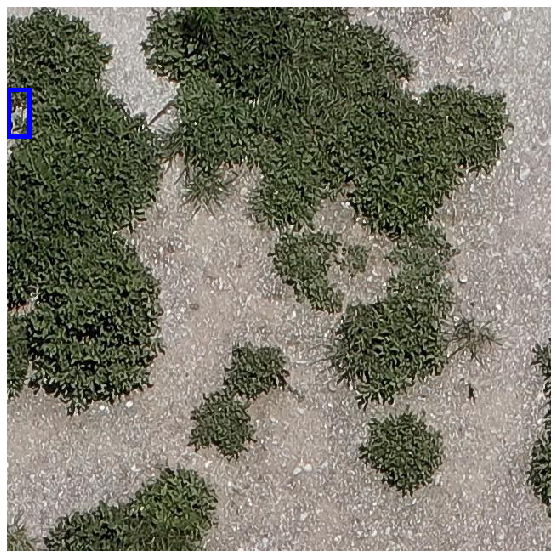

<Figure size 432x288 with 0 Axes>

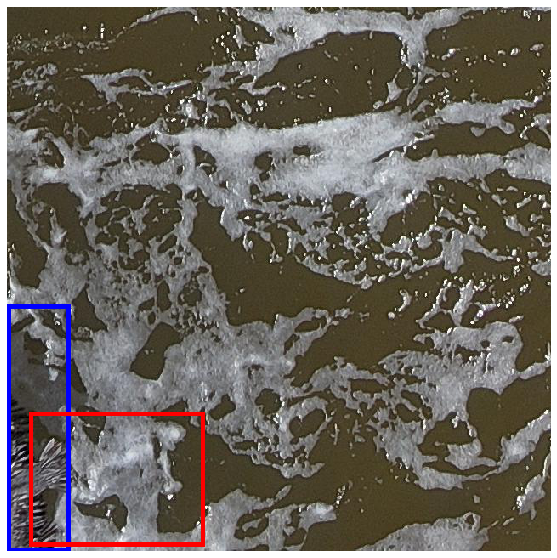

<Figure size 432x288 with 0 Axes>

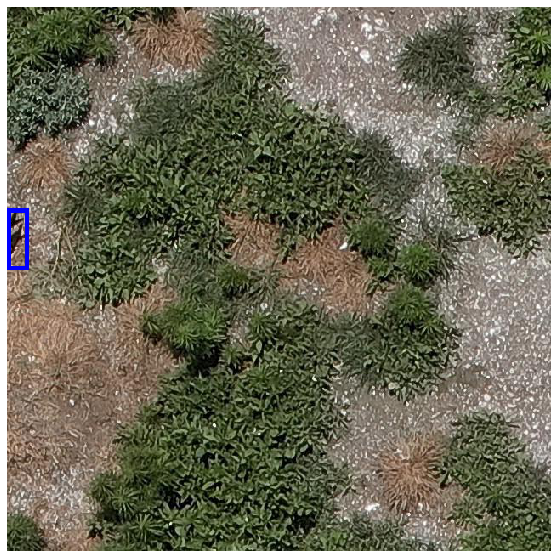

<Figure size 432x288 with 0 Axes>

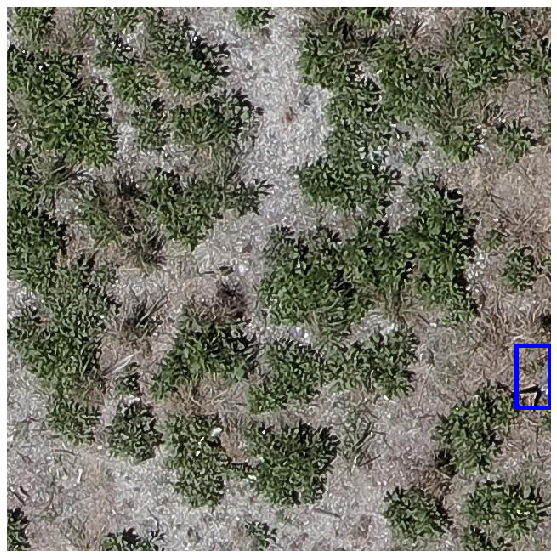

<Figure size 432x288 with 0 Axes>

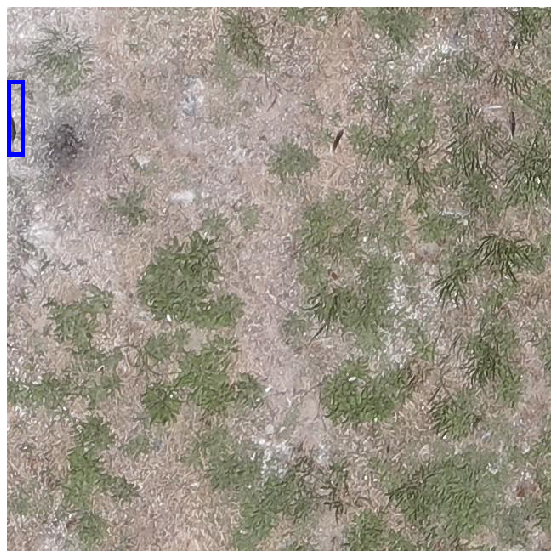

<Figure size 432x288 with 0 Axes>

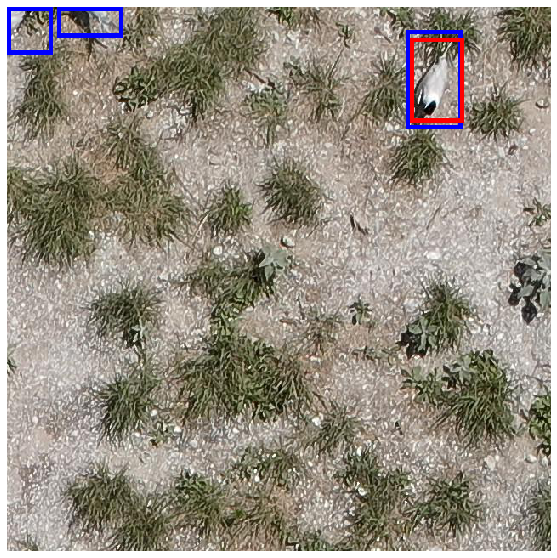

<Figure size 432x288 with 0 Axes>

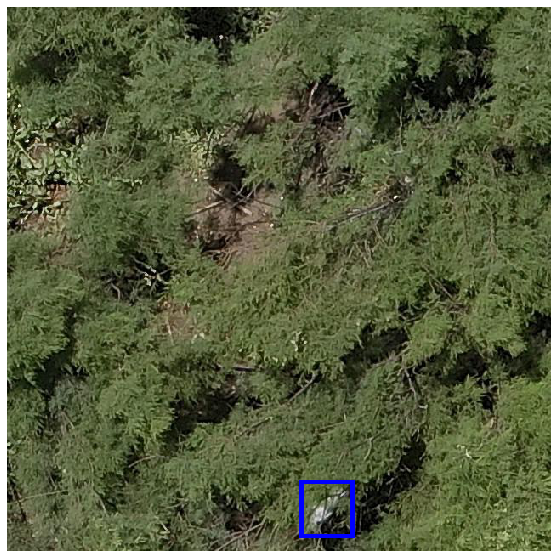

<Figure size 432x288 with 0 Axes>

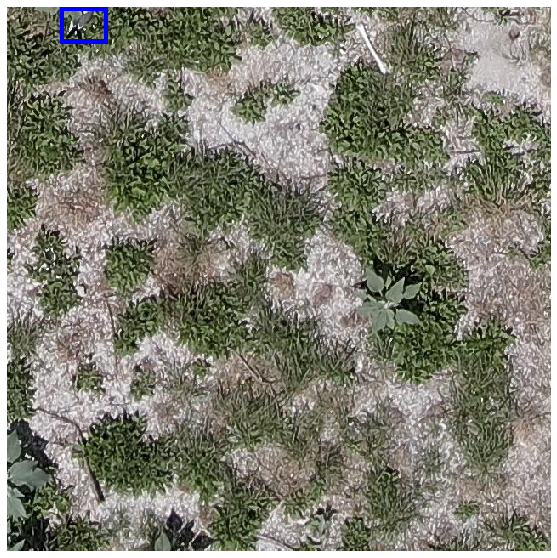

<Figure size 432x288 with 0 Axes>

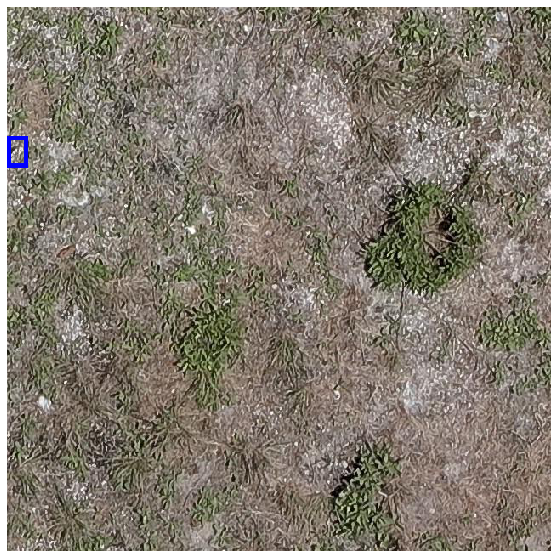

<Figure size 432x288 with 0 Axes>

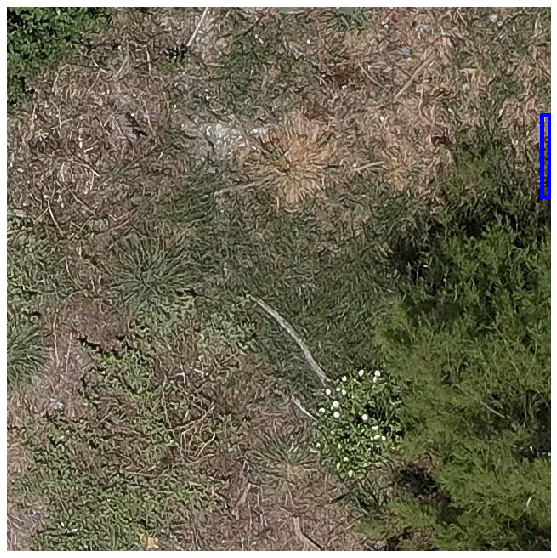

<Figure size 432x288 with 0 Axes>

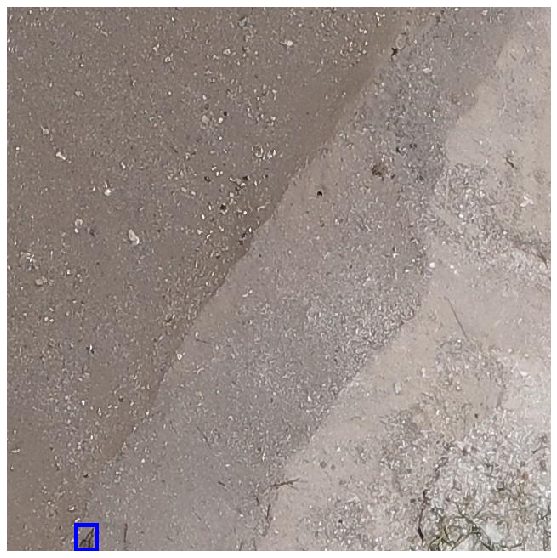

<Figure size 432x288 with 0 Axes>

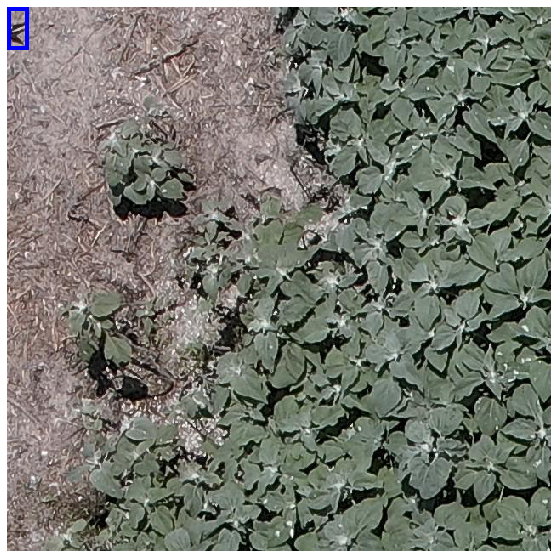

<Figure size 432x288 with 0 Axes>

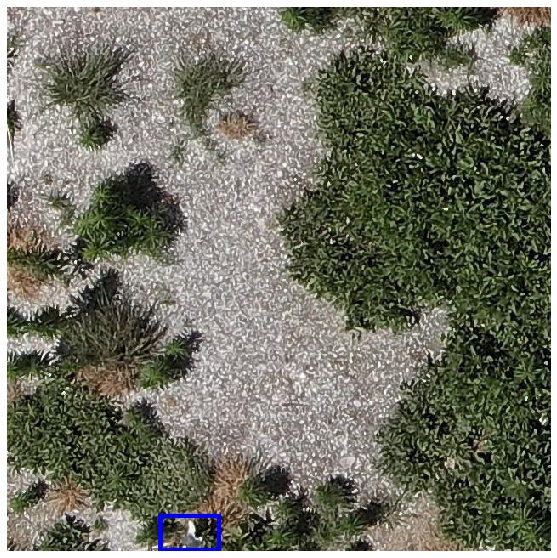

<Figure size 432x288 with 0 Axes>

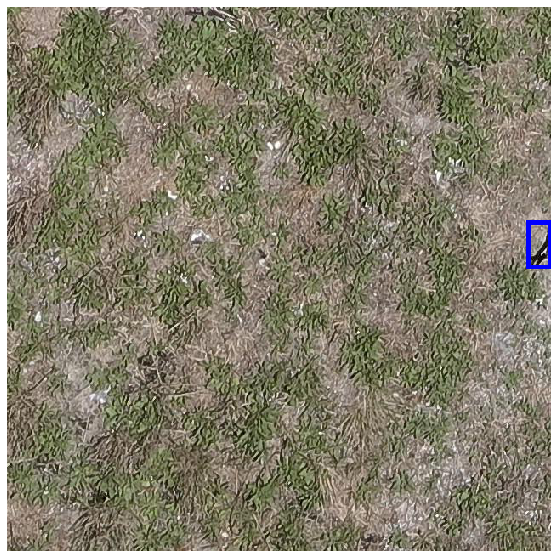

<Figure size 432x288 with 0 Axes>

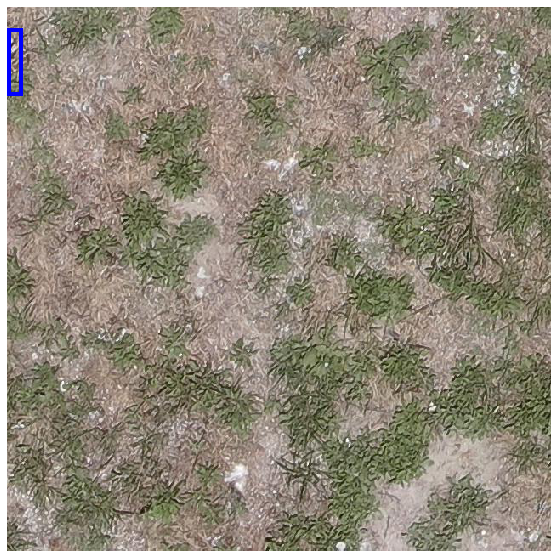

<Figure size 432x288 with 0 Axes>

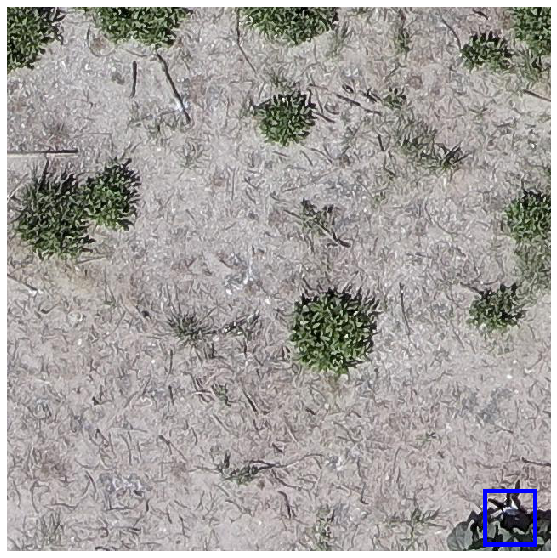

<Figure size 432x288 with 0 Axes>

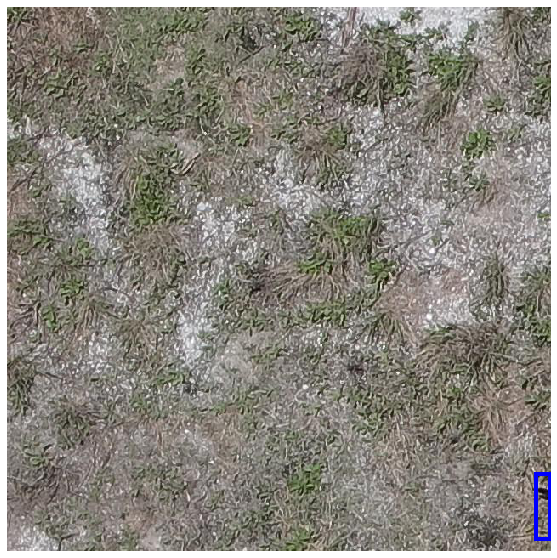

<Figure size 432x288 with 0 Axes>

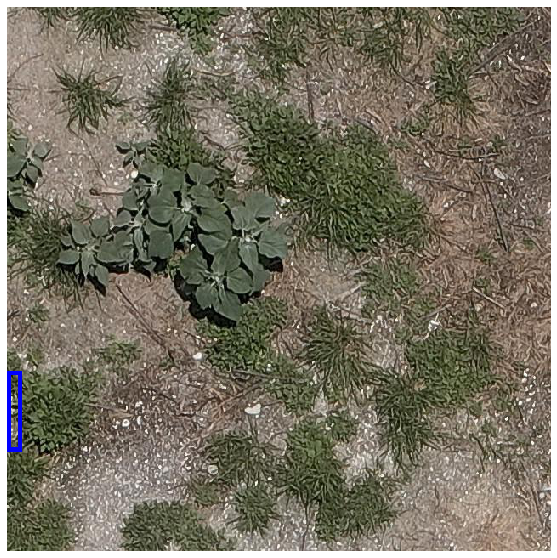

<Figure size 432x288 with 0 Axes>

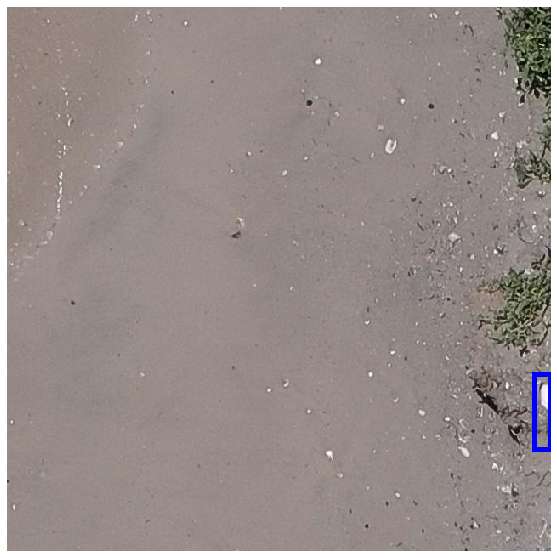

<Figure size 432x288 with 0 Axes>

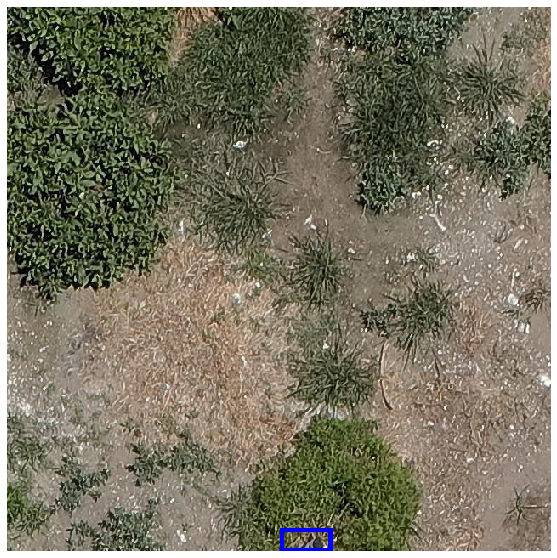

<Figure size 432x288 with 0 Axes>

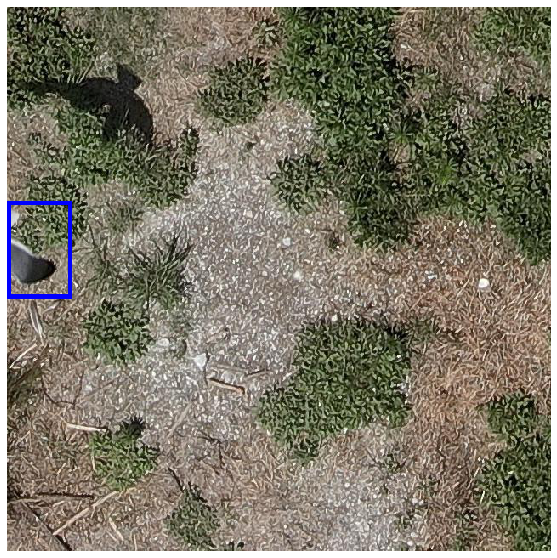

<Figure size 432x288 with 0 Axes>

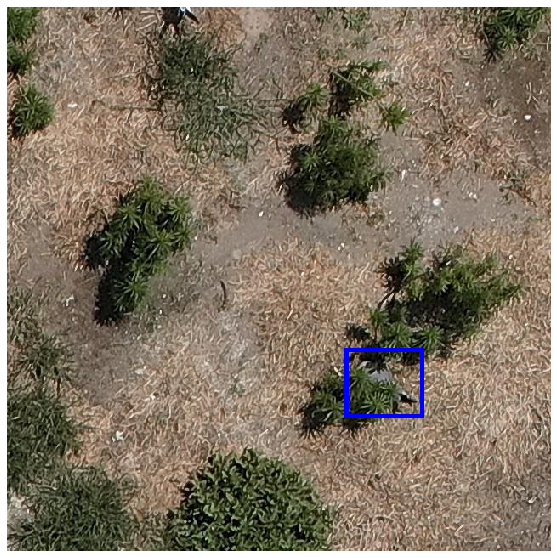

<Figure size 432x288 with 0 Axes>

In [ ]:
pred_total, truth_total = confusion_matrix_report(data, predictor)

In [ ]:
tt =pd.read_csv(file.replace('JPEG', 'csv'))

drop_index = []
for ind, val in enumerate(tt['class_id']):
  if val == 'TRASH':
    drop_index.append(ind)

tt.drop(index = drop_index, inplace = True)
tt.head()

,class_id,desc,x,y,width,height
0,LAGUA,Laughing Gull Adult,0,510,89,51
1,MTRNF,Mixed Tern Flying,489,493,151,147


  0%|          | 0/367 [00:00<?, ?it/s]

In [ ]:
from sklearn.metrics import confusion_matrix, classification_report

In [ ]:
confusion_matrix(truth_total, pred_total)

array([[   1,    0,    0,    0,    0,   76],
       [   0,    0,    0,    0,    0,  396],
       [   0,    0,    0,    0,    0, 1329],
       [   0,    0,    0,    0,    0,    5],
       [   0,    0,    0,    0,    0,    7],
       [   0,    0,    0,    0,    0,    0]])

In [ ]:
print(classification_report(truth_total, pred_total))

              precision    recall  f1-score   support

           0       1.00      0.01      0.03        77
           1       0.00      0.00      0.00       396
           2       0.00      0.00      0.00      1329
           4       0.00      0.00      0.00         5
           5       0.00      0.00      0.00         7
           6       0.00      0.00      0.00         0

    accuracy                           0.00      1814
   macro avg       0.17      0.00      0.00      1814
weighted avg       0.04      0.00      0.00      1814



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1

In [ ]:
im = cv2.imread(data[36]['file_name'])
outputs = predictor(im)

In [ ]:
outputs = outputs["instances"].to("cpu")
# outputs = outputs[outputs.scores > 0.0]
# print(outputs[outputs.scores > 0.0])
lst = list(outputs._fields.items())
print(outputs._fields.items())

dict_items([('pred_boxes', Boxes(tensor([[  1.3211, 123.1541,  92.3856, 188.7014],
        [  0.0000, 555.0617,  50.9149, 639.5773],
        [ 82.1329, 376.3700, 182.6026, 434.1325]]))), ('scores', tensor([0.9994, 0.9963, 0.9960])), ('pred_classes', tensor([1, 1, 1]))])


In [ ]:
(lst[-1][1]).numpy()

array([1, 1, 1])

In [ ]:
b1 = []
b2 =[]
# from torch._C import dtype
b1 = (lst[0][1][0].tensor[0]).numpy()

print(b1)
print(b2)
b2[2] = b2[0]+b2[2]
b2[3] =  b2[1]+b2[3]
print(b2)




[  1.3210663 123.15413    92.385574  188.70145  ]
[]


IndexError: ignored

In [ ]:
annt = pd.read_csv(data[3]['file_name'].replace('JPEG', 'csv'))
annt[['x','y', 'width','height']].to_numpy()[2]

array([  0, 283, 150, 221])

In [ ]:
annt

,class_id,desc,x,y,width,height
0,LAGUA,Laughing Gull Adult,0,379,10,83
